## Installing packages
> Since these are zarr file for tomogram data, we need to use zarr, ome-zarr and copick package
> The Information in Data tab also suggests the same

In [1]:
!pip install -q zarr ome-zarr copick

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 210.7/210.7 kB 4.3 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.7/46.7 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.6/8.6 MB 71.0 MB/s eta 0:00:00:00:010:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 707.0/707.0 kB 31.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 203.4/203.4 kB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 74.0/74.0 kB 3.6 MB/s eta 0:00:00


## Loading Libraries

In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import zarr
from pathlib import Path

## Reading data

### As per the data, we have tomogram data represented by zarr filesets and there is also particle.json file which is data about each particle.

### Reading data ways
- `zarr files`: Using zarr package
- `json files`:  Its a json format so we can read it through json package.


### Reading tomogram data

In [3]:
train_zarr_path = Path('/kaggle/input/czii-cryo-et-object-identification/train/static/ExperimentRuns/TS_5_4/VoxelSpacing10.000/denoised.zarr')
train_zarr_data = zarr.open(str(train_zarr_path))

# printing data about zarr store
print("Zarr file contains:")
print(train_zarr_data.tree())

Zarr file contains:
/
 ├── 0 (184, 630, 630) float32
 ├── 1 (92, 315, 315) float32
 └── 2 (46, 158, 158) float32


There are three scales and the first one is with the highest resolution

In [4]:
tomogram_ts_5_4 = train_zarr_data[0][:]

print(f"Tomogram shape: {tomogram_ts_5_4.shape}")
print(f"Tomogram DataType: {tomogram_ts_5_4.dtype}")
print(f"Tomogram minimum value: {tomogram_ts_5_4.min()}")
print(f"Tomogram maximum value: {tomogram_ts_5_4.max()}")
print(f"Tomogram Mean value: {tomogram_ts_5_4.mean()}")


Tomogram shape: (184, 630, 630)
Tomogram DataType: float32
Tomogram minimum value: -0.00032409786945208907
Tomogram maximum value: 0.00015229516429826617
Tomogram Mean value: 2.065016531105357e-07


## Reading first apo feritin particle JSON data

In [5]:
import json

apo_ferritin_json_path = Path('/kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns/TS_5_4/Picks/apo-ferritin.json')

with open(apo_ferritin_json_path, 'r') as f:
    data = json.load(f)

# Visualize the structure
print("Keys in the JSON file: ", data.keys())
print("First few points:");
print(json.dumps(data['points'][:2], indent=2))

Keys in the JSON file:  dict_keys(['pickable_object_name', 'user_id', 'session_id', 'run_name', 'voxel_spacing', 'unit', 'points', 'trust_orientation'])
First few points:
[
  {
    "location": {
      "x": 468.514,
      "y": 5915.906,
      "z": 604.167
    },
    "transformation_": [
      [
        1.0,
        0.0,
        0.0,
        0.0
      ],
      [
        0.0,
        1.0,
        0.0,
        0.0
      ],
      [
        0.0,
        0.0,
        1.0,
        0.0
      ],
      [
        0.0,
        0.0,
        0.0,
        1.0
      ]
    ],
    "instance_id": 0
  },
  {
    "location": {
      "x": 5674.694,
      "y": 1114.354,
      "z": 565.068
    },
    "transformation_": [
      [
        1.0,
        0.0,
        0.0,
        0.0
      ],
      [
        0.0,
        1.0,
        0.0,
        0.0
      ],
      [
        0.0,
        0.0,
        1.0,
        0.0
      ],
      [
        0.0,
        0.0,
        0.0,
        1.0
      ]
    ],
    "instance_id

> From above we can say that there are points in the 3dimension space and is represented in location key

## Getting the range of the XYZ coordinates in the apo-ferritin particle

In [6]:
apo_data = data
coords = list()
# inside each point we have location
for point in apo_data["points"]:
    x, y, z = (point["location"][key] for key in ['x', 'y', 'z'])
    coords.append([x, y, z])
coords = np.array(coords)
print(f"Total points coordinates: {len(coords)}")
print(f"X range: {coords[:,0].min()} to {coords[0].max()}")
print(f"Y range: {coords[:,1].min()} to {coords[1].max()}")
print(f"Z range: {coords[:,2].min()} to {coords[2].max()}")


Total points coordinates: 46
X range: 468.514 to 5915.906
Y range: 1049.172 to 5674.694
Z range: 76.321 to 5744.509


> As per the above few observations, we can say that the scales of tomogram and the particle does not match and we need to scale or normalize the particles range to match the tomogram shape. Therefore the next step should be feature scaling or scaling the coordinates range

In [7]:
# tomogram shape
tomogram_ts_5_4.shape

(184, 630, 630)

### The particle's range should match the above i.e it should range till 
> - What are the dimensions in tomogram data represent
    - First dimension (184): This represents the depth which is the z coordinate
    - Second Dimension (630): This represents rows in the image slices which is the y coordinate
    - Third dimension (630): This represents columns in the image slices which is the x coordinate

- So our particle ranges

- Z coordinate should range till max of 184

- Y and X coordinate should range till max of 630

- To scale this way, we can simply divide Z with 184, X and Y with 630

## Scaling the coordinates

In [8]:
def scale_coordinates(coords, tomogram_shape):
    scaled_coords = coords.copy()
    
    # Scale factors for each dimension
    scale_z = tomogram_shape[0] / coords[:, 2].max() # 184 / 5744.509
    scale_y = tomogram_shape[1] / coords[:, 1].max()
    scale_x = tomogram_shape[2] / coords[:, 0].max()
    
    # Apply scaling
    scaled_coords[:, 2] = coords[:, 2] * scale_z
    scaled_coords[:, 1] = coords[:, 1] * scale_y
    scaled_coords[:, 0] = coords[:, 0] * scale_x
    
    return scaled_coords

# Scale the coordinates
scaled_coords = scale_coordinates(coords, tomogram_ts_5_4.shape)

print("\nCoordinate ranges after scaling:")
print(f"X range: {scaled_coords[:, 0].min():.1f} to {scaled_coords[:, 0].max():.1f}")
print(f"Y range: {scaled_coords[:, 1].min():.1f} to {scaled_coords[:, 1].max():.1f}")
print(f"Z range: {scaled_coords[:, 2].min():.1f} to {scaled_coords[:, 2].max():.1f}")


Coordinate ranges after scaling:
X range: 50.2 to 630.0
Y range: 111.7 to 630.0
Z range: 10.8 to 184.0


## Visualizing the apo ferritin particle

In [9]:
import matplotlib.pyplot as plt
import numpy as np

def visualize_apo_ferritin_particle(tomogram, coords, n_slices=3, slice_thickness=10):
    """
    Visualizing apo-ferritin particles in tomogram slices using subplots.
    
    Parameters:
        tomogram (ndarray): 3D tomogram array.
        coords (ndarray): Array of particle coordinates [x, y, z].
        n_slices (int): Number of slices to display.
        slice_thickness (int): Range around each slice to include particles.
    """
    # Normalize tomogram for consistent visualization
    vmin, vmax = np.percentile(tomogram, (1, 99))
    normalized_tomogram = np.clip((tomogram - vmin) / (vmax - vmin), 0, 1)

    # Calculate z-positions for the slices
    z_positions = np.linspace(0, tomogram.shape[0] - 1, n_slices, dtype=int)

    # Create subplots
    fig, axes = plt.subplots(1, n_slices, figsize=(20, 8), constrained_layout=True)
    
    for idx, ax in enumerate(axes):
        z = z_positions[idx]

        # Display the tomogram slice
        im = ax.imshow(normalized_tomogram[z, :, :], cmap='gray', vmin=0, vmax=1)
        
        # Highlight particles near the current slice
        mask = np.abs(coords[:, 2] - z) < slice_thickness
        if np.any(mask):
            ax.scatter(
                coords[mask, 0], coords[mask, 1],
                color='red', marker='o', s=100,
                facecolors='none', linewidth=2,
                label='apo-ferritin'
            )
        
        # Customize the subplot
        ax.set_title(f"Slice Z={z}\n({np.sum(mask)} particles visible)")
        ax.set_xlim(0, tomogram.shape[2])
        ax.set_ylim(tomogram.shape[1], 0)  # Invert y-axis for correct orientation
        ax.axis('off')  # Turn off axes for cleaner visualization
    
    # Add a single colorbar for the figure
    cbar = fig.colorbar(im, ax=axes, location='right', shrink=0.7, pad=0.05)
    cbar.set_label('Normalized Intensity', fontsize=12)

    # Add a shared title
    fig.suptitle(
        f"Apo-ferritin Particles in Tomogram Slices\n"
        f"Displaying particles within ±{slice_thickness} units of each slice",
        fontsize=16
    )

    # Show legend on the first subplot
    axes[0].legend(loc='upper right')
    
    plt.show()


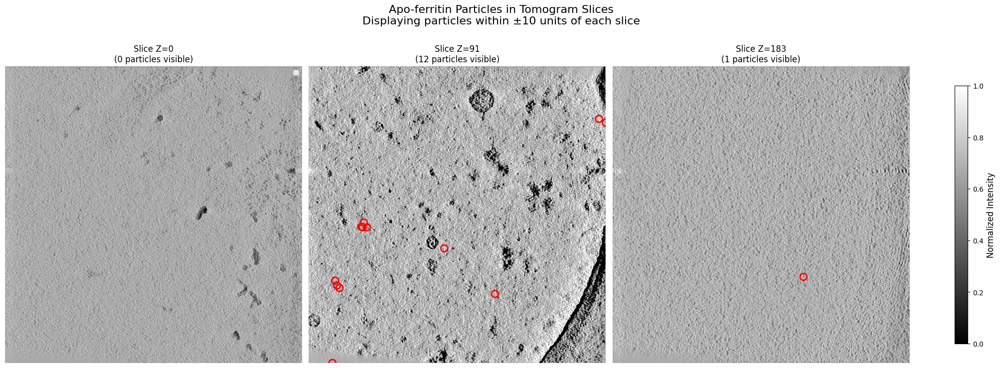

In [10]:
# Create the visualization with scaled coordinates
visualize_apo_ferritin_particle(tomogram_ts_5_4, scaled_coords)

## Loading all the particle coordinates. 
 - For each particle, we will combine all the coordinates

In [11]:
PARTICLE_MAP = {
    'apo-ferritin': {'color': '#FF3333', 'marker': 'o', 'difficulty': 'easy'},          # Bright red
    'beta-amylase': {'color': '#FFFFFF', 'marker': 's', 'difficulty': 'impossible'},     # White
    'beta-galactosidase': {'color': '#33FFFF', 'marker': '^', 'difficulty': 'hard'},    # Cyan
    'ribosome': {'color': '#33FF33', 'marker': 'D', 'difficulty': 'easy'},              # Bright green
    'thyroglobulin': {'color': '#FF33FF', 'marker': 'p', 'difficulty': 'hard'},         # Magenta
    'virus-like-particle': {'color': '#FFFF33', 'marker': '*', 'difficulty': 'easy'}     # Yellow
}

EXPERIMENT_NAMES = ["TS_5_4", "TS_69_2", "TS_6_4", "TS_6_6", "TS_73_6", "TS_86_3", "TS_99_9"]

### Loading particles for experiment TS_5_4

In [12]:
def load_particle_coordinates(experiment_name="TS_5_4"):
    base_path = Path("/kaggle/input/czii-cryo-et-object-identification/train/overlay/ExperimentRuns")
    particle_coords = {}
    print("-" * 50)
    for particle in PARTICLE_MAP:
        particle_path = base_path / experiment_name / 'Picks' / f'{particle}.json'
        try:
            with open(particle_path, 'r') as f:
                data = json.load(f)
                coords = list()
                # inside each point we have location
                for point in data["points"]:
                    x, y, z = (point["location"][key] for key in ['x', 'y', 'z'])
                    coords.append([x, y, z])
                coords = np.array(coords)
                particle_coords[particle] = coords
                print(f"Loaded {len(coords)} {particle} coordinates")
        except Exception as e:
            print(f"Error reading {particle} coordinates: {e}")
            particle_coords[particle] = np.array([])
    return particle_coords

## Visualizing all the particle coordinates

For doing the above we need
- all the particle coordinates for an experiment
- scale all these coordinates properly to tomogram shape
- visualize

In [13]:
def visualize_all_particles(tomogram, particle_coords, experiment_name="TS_5_4", print_statistics=True, n_slices=3, slice_thickness=10):
    """
    Visualizing all particles in tomogram slices using subplots.
    
    Parameters:
        tomogram (ndarray): 3D tomogram array.
        coords (ndarray): Array of particle coordinates [x, y, z].
        n_slices (int): Number of slices to display.
        slice_thickness (int): Range around each slice to include particles.
    """
    # Normalize tomogram for consistent visualization
    vmin, vmax = np.percentile(tomogram, (1, 99))
    normalized_tomogram = np.clip((tomogram - vmin) / (vmax - vmin), 0, 1)

    # Calculate z-positions for the slices
    all_z_coords = []
    for coords in particle_coords.values():
        if len(coords):
            all_z_coords.extend(coords[:, 2])
    
    if all_z_coords:
        z_coords = np.array(all_z_coords)
        z_density = np.histogram(z_coords, bins=50)[0]
        highest_density_indices = np.argsort(z_density)[-n_slices:]
        z_positions = np.linspace(z_coords.min(), z_coords.max(), 51)[highest_density_indices]
    else:
        z_positions = np.linspace(0, tomogram.shape[0]-1, n_slices, dtype=int)
    

    # Create subplots
    fig, axes = plt.subplots(1, n_slices, figsize=(20, 8), constrained_layout=True)
    
    for idx, ax in enumerate(axes):
        z = int(z_positions[idx])

        # Display the tomogram slice
        im = ax.imshow(normalized_tomogram[z, :, :], cmap='gray', vmin=0, vmax=1)

        # plot each particle type
        particles_in_slice = 0
        particle_counts = {}
        for particle_type, coords in particle_coords.items():
            if len(coords):
                
        
                # Highlight particles near the current slice
                mask = np.abs(coords[:, 2] - z) < slice_thickness
                if np.any(mask):
                    style = PARTICLE_MAP[particle_type]
                    ax.scatter(
                        coords[mask, 0], coords[mask, 1],
                        color=style['color'], marker=style['marker'], s=100,
                        facecolors='none', linewidth=2,
                        label=f"{particle_type}\n({style['difficulty']})"
                    )
                    count = np.sum(mask)
                    particles_in_slice += count
                    particle_counts[particle_type] = count 
        
        # Customize the subplot
        # Create detailed title showing counts for each particle type
        title_parts = [f'Slice Z={z}']
        if particle_counts:
            for ptype, count in particle_counts.items():
                if count > 0:
                    title_parts.append(f'{ptype}: {count}')
        title = '\n'.join(title_parts)
        ax.set_title(title, fontsize=8)

        
        ax.set_xlim(0, tomogram.shape[2])
        ax.set_ylim(tomogram.shape[1], 0)  # Invert y-axis for correct orientation
        ax.axis('off')  # Turn off axes for cleaner visualization

        # Add legend with semi-transparent background for better visibility
        if idx == 0:  # Only add legend to first subplot
            handles, labels = ax.get_legend_handles_labels()
            legend = ax.legend(handles, labels,
                             bbox_to_anchor=(0.02, 0.98), 
                             loc='upper left',
                             borderaxespad=0.,
                             framealpha=0.8,
                             facecolor='black',
                             edgecolor='white',
                             labelcolor='white',
                             fontsize=8)
            
            for handle in handles:
                handle.set_edgecolor('black')
                handle.set_linewidth(1.5)
    
    # Add a single colorbar for the figure
    cbar = fig.colorbar(im, ax=axes, location='right', shrink=0.7, pad=0.05)
    cbar.set_label('Normalized Intensity', fontsize=12)

    # Add a shared title
    fig.suptitle(f'All Particle Types for experiment {experiment_name} in Tomogram Slices\n' + 
             f'Showing particles within ±{slice_thickness} units of each slice',
             fontsize=16, y=1.05)

    # Show legend on the first subplot
    axes[0].legend(loc='upper right')
    
    plt.show()
    if print_statistics:
        # Print overall particle statistics
        print("\nOverall Particle Statistics:")
        print("-" * 50)
        for particle_type, coords in particle_coords.items():
            if len(coords) > 0:
                print(f"\n{particle_type} ({PARTICLE_MAP[particle_type]['difficulty']}):")
                print(f"Total particles: {len(coords)}")
                print(f"Z range: {coords[:, 2].min():.1f} to {coords[:, 2].max():.1f}")

--------------------------------------------------
Loaded 46 apo-ferritin coordinates
Loaded 10 beta-amylase coordinates
Loaded 12 beta-galactosidase coordinates
Loaded 31 ribosome coordinates
Loaded 30 thyroglobulin coordinates
Loaded 11 virus-like-particle coordinates


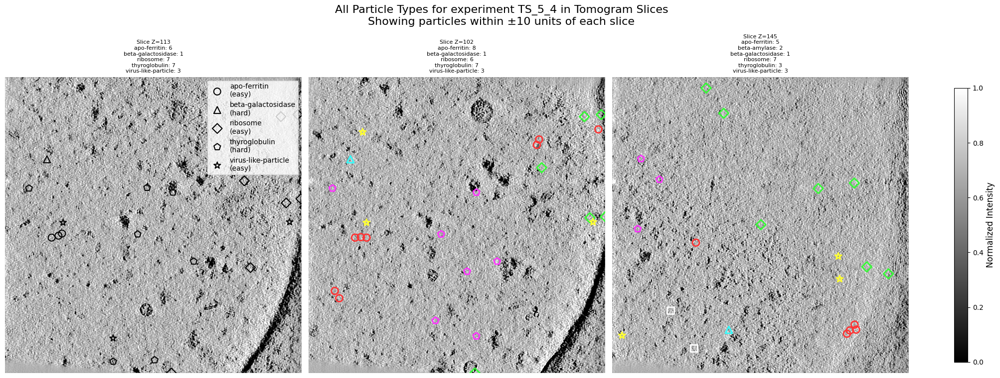


Overall Particle Statistics:
--------------------------------------------------

apo-ferritin (easy):
Total particles: 46
Z range: 10.8 to 184.0

beta-amylase (impossible):
Total particles: 10
Z range: 40.2 to 184.0

beta-galactosidase (hard):
Total particles: 12
Z range: 7.4 to 184.0

ribosome (easy):
Total particles: 31
Z range: 32.0 to 184.0

thyroglobulin (hard):
Total particles: 30
Z range: 16.3 to 184.0

virus-like-particle (easy):
Total particles: 11
Z range: 58.7 to 184.0

Particle Statistics:
--------------------------------------------------

apo-ferritin (easy):
Number of particles: 46
X range: 50.2 to 630.0
Y range: 111.7 to 630.0
Z range: 10.8 to 184.0

beta-amylase (impossible):
Number of particles: 10
X range: 119.2 to 630.0
Y range: 153.6 to 630.0
Z range: 40.2 to 184.0

beta-galactosidase (hard):
Number of particles: 12
X range: 52.9 to 630.0
Y range: 84.6 to 630.0
Z range: 7.4 to 184.0

ribosome (easy):
Number of particles: 31
X range: 85.9 to 630.0
Y range: 23.8 to 

In [14]:
all_particle_coords = load_particle_coordinates()
scale_particle_coords = { particle_type: scale_coordinates(coords, tomogram_ts_5_4.shape)
    for particle_type, coords in all_particle_coords.items() }
visualize_all_particles(tomogram_ts_5_4, scale_particle_coords)
# Print statistics for each particle type
print("\nParticle Statistics:")
print("-" * 50)
for particle_type, coords in scale_particle_coords.items():
    if len(coords) > 0:
        print(f"\n{particle_type} ({PARTICLE_MAP[particle_type]['difficulty']}):")
        print(f"Number of particles: {len(coords)}")
        print(f"X range: {coords[:, 0].min():.1f} to {coords[:, 0].max():.1f}")
        print(f"Y range: {coords[:, 1].min():.1f} to {coords[:, 1].max():.1f}")
        print(f"Z range: {coords[:, 2].min():.1f} to {coords[:, 2].max():.1f}")

## Visualize for other experiments

In [15]:
# FIRST findout all the tomogram shapes for each experiment
# we already have tomogram data for ts_5_4
EXPERIMENT_MAP = {} # name: tomogram
for experiment_name in EXPERIMENT_NAMES:
    train_zarr_path = Path(f'/kaggle/input/czii-cryo-et-object-identification/train/static/ExperimentRuns/{experiment_name}/VoxelSpacing10.000/denoised.zarr')
    train_zarr_data = zarr.open(str(train_zarr_path))
    
    # printing data about zarr store
    print(f"{experiment_name} Zarr file contains:")
    print(train_zarr_data.tree())
    tomogram = train_zarr_data[0][:]
    EXPERIMENT_MAP[experiment_name] = tomogram


TS_5_4 Zarr file contains:
/
 ├── 0 (184, 630, 630) float32
 ├── 1 (92, 315, 315) float32
 └── 2 (46, 158, 158) float32
TS_69_2 Zarr file contains:
/
 ├── 0 (184, 630, 630) float32
 ├── 1 (92, 315, 315) float32
 └── 2 (46, 158, 158) float32
TS_6_4 Zarr file contains:
/
 ├── 0 (184, 630, 630) float32
 ├── 1 (92, 315, 315) float32
 └── 2 (46, 158, 158) float32
TS_6_6 Zarr file contains:
/
 ├── 0 (184, 630, 630) float32
 ├── 1 (92, 315, 315) float32
 └── 2 (46, 158, 158) float32
TS_73_6 Zarr file contains:
/
 ├── 0 (184, 630, 630) float32
 ├── 1 (92, 315, 315) float32
 └── 2 (46, 158, 158) float32
TS_86_3 Zarr file contains:
/
 ├── 0 (184, 630, 630) float32
 ├── 1 (92, 315, 315) float32
 └── 2 (46, 158, 158) float32
TS_99_9 Zarr file contains:
/
 ├── 0 (184, 630, 630) float32
 ├── 1 (92, 315, 315) float32
 └── 2 (46, 158, 158) float32


--------------------------------------------------
Loaded 46 apo-ferritin coordinates
Loaded 10 beta-amylase coordinates
Loaded 12 beta-galactosidase coordinates
Loaded 31 ribosome coordinates
Loaded 30 thyroglobulin coordinates
Loaded 11 virus-like-particle coordinates


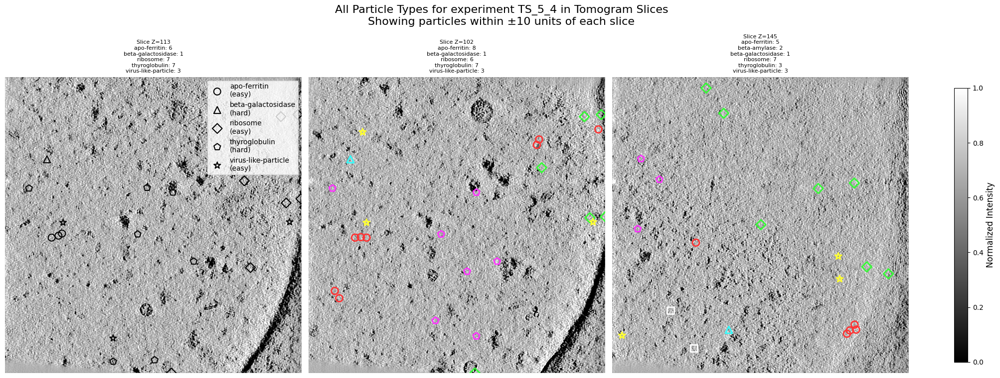


Particle Statistics for TS_5_4:
--------------------------------------------------

apo-ferritin (easy):
Number of particles: 46
X range: 50.2 to 630.0
Y range: 111.7 to 630.0
Z range: 10.8 to 184.0

beta-amylase (impossible):
Number of particles: 10
X range: 119.2 to 630.0
Y range: 153.6 to 630.0
Z range: 40.2 to 184.0

beta-galactosidase (hard):
Number of particles: 12
X range: 52.9 to 630.0
Y range: 84.6 to 630.0
Z range: 7.4 to 184.0

ribosome (easy):
Number of particles: 31
X range: 85.9 to 630.0
Y range: 23.8 to 630.0
Z range: 32.0 to 184.0

thyroglobulin (hard):
Number of particles: 30
X range: 50.9 to 630.0
Y range: 23.2 to 630.0
Z range: 16.3 to 184.0

virus-like-particle (easy):
Number of particles: 11
X range: 21.5 to 630.0
Y range: 117.4 to 630.0
Z range: 58.7 to 184.0
--------------------------------------------------
Loaded 35 apo-ferritin coordinates
Loaded 12 beta-amylase coordinates
Loaded 16 beta-galactosidase coordinates
Loaded 37 ribosome coordinates
Loaded 34 thyr

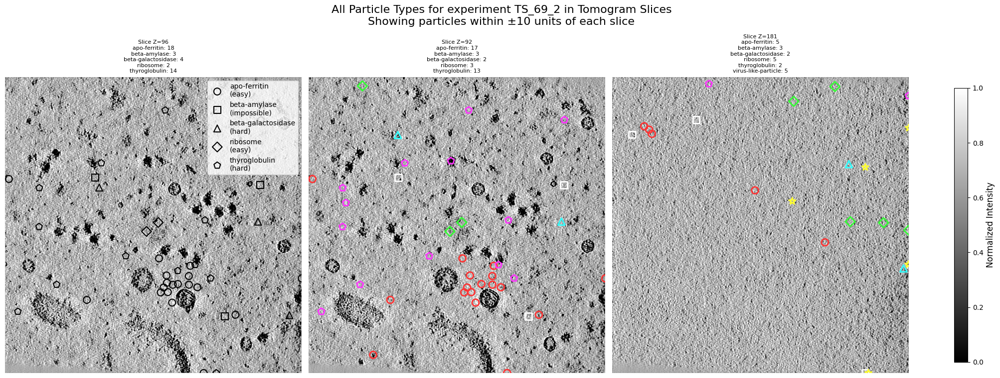


Particle Statistics for TS_69_2:
--------------------------------------------------

apo-ferritin (easy):
Number of particles: 35
X range: 8.4 to 630.0
Y range: 59.8 to 630.0
Z range: 82.6 to 184.0

beta-amylase (impossible):
Number of particles: 12
X range: 42.7 to 630.0
Y range: 42.9 to 630.0
Z range: 97.9 to 184.0

beta-galactosidase (hard):
Number of particles: 16
X range: 157.3 to 630.0
Y range: 13.2 to 630.0
Z range: 84.7 to 184.0

ribosome (easy):
Number of particles: 37
X range: 59.8 to 630.0
Y range: 19.2 to 630.0
Z range: 82.3 to 184.0

thyroglobulin (hard):
Number of particles: 34
X range: 27.4 to 630.0
Y range: 14.8 to 630.0
Z range: 77.0 to 184.0

virus-like-particle (easy):
Number of particles: 9
X range: 25.1 to 630.0
Y range: 83.3 to 630.0
Z range: 126.6 to 184.0
--------------------------------------------------
Loaded 58 apo-ferritin coordinates
Loaded 9 beta-amylase coordinates
Loaded 12 beta-galactosidase coordinates
Loaded 74 ribosome coordinates
Loaded 30 thyrogl

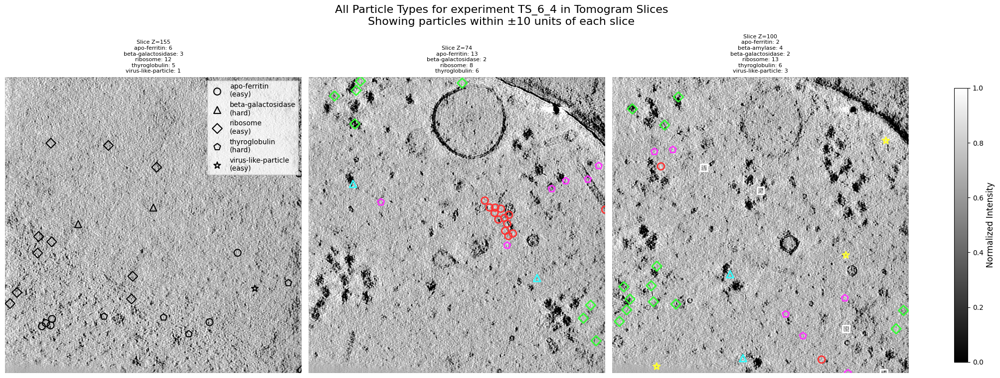


Particle Statistics for TS_6_4:
--------------------------------------------------

apo-ferritin (easy):
Number of particles: 58
X range: 63.5 to 630.0
Y range: 91.7 to 630.0
Z range: 27.2 to 184.0

beta-amylase (impossible):
Number of particles: 9
X range: 172.8 to 630.0
Y range: 115.2 to 630.0
Z range: 26.2 to 184.0

beta-galactosidase (hard):
Number of particles: 12
X range: 29.4 to 630.0
Y range: 186.7 to 630.0
Z range: 71.9 to 184.0

ribosome (easy):
Number of particles: 74
X range: 10.7 to 630.0
Y range: 9.0 to 630.0
Z range: 46.3 to 184.0

thyroglobulin (hard):
Number of particles: 30
X range: 32.9 to 630.0
Y range: 121.7 to 630.0
Z range: 23.5 to 184.0

virus-like-particle (easy):
Number of particles: 10
X range: 12.7 to 630.0
Y range: 135.6 to 630.0
Z range: 106.3 to 184.0
--------------------------------------------------
Loaded 41 apo-ferritin coordinates
Loaded 14 beta-amylase coordinates
Loaded 11 beta-galactosidase coordinates
Loaded 23 ribosome coordinates
Loaded 35 thy

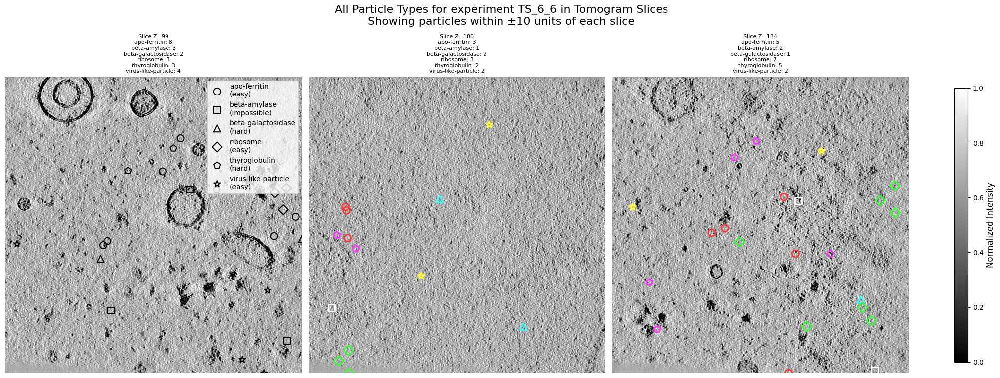


Particle Statistics for TS_6_6:
--------------------------------------------------

apo-ferritin (easy):
Number of particles: 41
X range: 31.0 to 630.0
Y range: 48.2 to 630.0
Z range: 7.2 to 184.0

beta-amylase (impossible):
Number of particles: 14
X range: 49.1 to 630.0
Y range: 121.5 to 630.0
Z range: 29.0 to 184.0

beta-galactosidase (hard):
Number of particles: 11
X range: 153.2 to 630.0
Y range: 168.3 to 630.0
Z range: 76.4 to 184.0

ribosome (easy):
Number of particles: 23
X range: 64.7 to 630.0
Y range: 228.0 to 630.0
Z range: 89.1 to 184.0

thyroglobulin (hard):
Number of particles: 35
X range: 23.8 to 630.0
Y range: 63.7 to 630.0
Z range: 38.7 to 184.0

virus-like-particle (easy):
Number of particles: 19
X range: 25.8 to 630.0
Y range: 52.6 to 630.0
Z range: 39.4 to 184.0
--------------------------------------------------
Loaded 95 apo-ferritin coordinates
Loaded 12 beta-amylase coordinates
Loaded 14 beta-galactosidase coordinates
Loaded 46 ribosome coordinates
Loaded 28 thyr

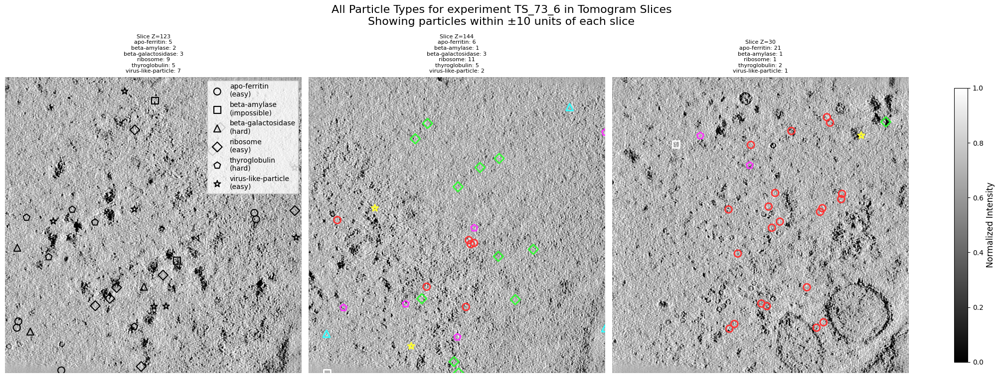


Particle Statistics for TS_73_6:
--------------------------------------------------

apo-ferritin (easy):
Number of particles: 95
X range: 8.8 to 630.0
Y range: 13.0 to 630.0
Z range: 5.4 to 184.0

beta-amylase (impossible):
Number of particles: 12
X range: 39.0 to 630.0
Y range: 23.1 to 630.0
Z range: 23.9 to 184.0

beta-galactosidase (hard):
Number of particles: 14
X range: 26.1 to 630.0
Y range: 38.3 to 630.0
Z range: 41.6 to 184.0

ribosome (easy):
Number of particles: 46
X range: 105.0 to 630.0
Y range: 52.5 to 630.0
Z range: 16.0 to 184.0

thyroglobulin (hard):
Number of particles: 28
X range: 41.7 to 630.0
Y range: 28.2 to 630.0
Z range: 10.3 to 184.0

virus-like-particle (easy):
Number of particles: 22
X range: 69.4 to 630.0
Y range: 30.6 to 630.0
Z range: 11.2 to 184.0
--------------------------------------------------
Loaded 64 apo-ferritin coordinates
Loaded 9 beta-amylase coordinates
Loaded 23 beta-galactosidase coordinates
Loaded 55 ribosome coordinates
Loaded 45 thyroglo

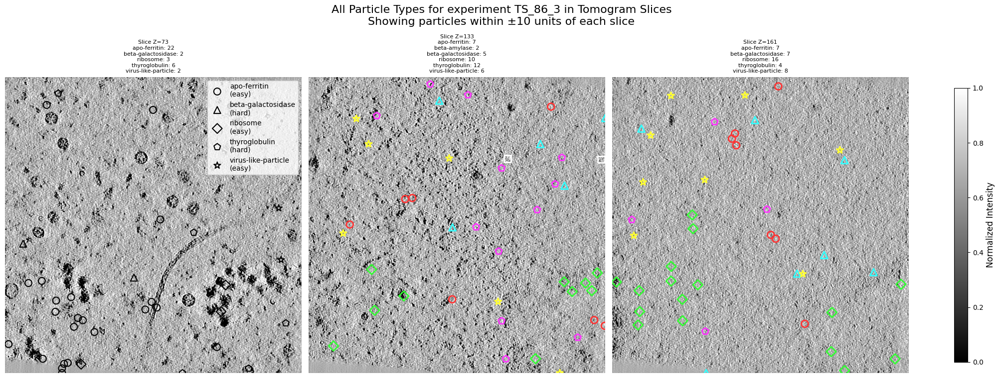


Particle Statistics for TS_86_3:
--------------------------------------------------

apo-ferritin (easy):
Number of particles: 64
X range: 7.6 to 630.0
Y range: 20.1 to 630.0
Z range: 56.0 to 184.0

beta-amylase (impossible):
Number of particles: 9
X range: 36.6 to 630.0
Y range: 43.5 to 630.0
Z range: 114.6 to 184.0

beta-galactosidase (hard):
Number of particles: 23
X range: 38.5 to 630.0
Y range: 24.2 to 630.0
Z range: 76.1 to 184.0

ribosome (easy):
Number of particles: 55
X range: 9.6 to 630.0
Y range: 214.5 to 630.0
Z range: 75.7 to 184.0

thyroglobulin (hard):
Number of particles: 45
X range: 40.7 to 630.0
Y range: 15.4 to 630.0
Z range: 26.4 to 184.0

virus-like-particle (easy):
Number of particles: 29
X range: 15.9 to 630.0
Y range: 18.7 to 630.0
Z range: 75.2 to 184.0
--------------------------------------------------
Loaded 36 apo-ferritin coordinates
Loaded 21 beta-amylase coordinates
Loaded 24 beta-galactosidase coordinates
Loaded 65 ribosome coordinates
Loaded 49 thyrogl

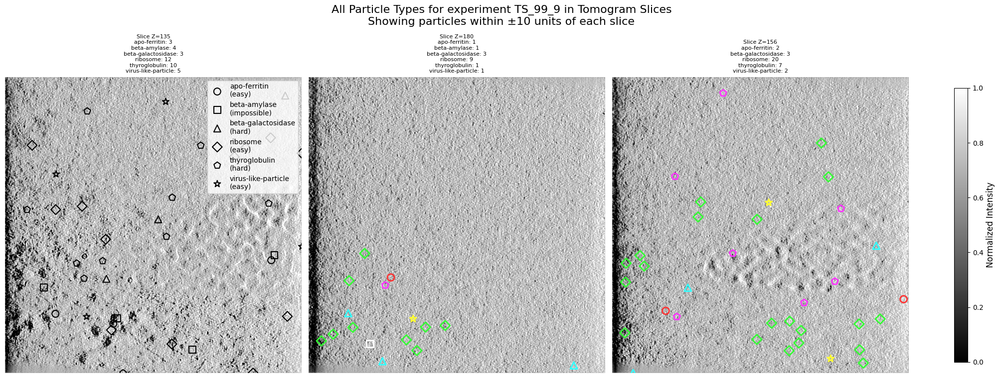


Particle Statistics for TS_99_9:
--------------------------------------------------

apo-ferritin (easy):
Number of particles: 36
X range: 47.5 to 630.0
Y range: 75.2 to 630.0
Z range: 34.1 to 184.0

beta-amylase (impossible):
Number of particles: 21
X range: 82.2 to 630.0
Y range: 23.8 to 630.0
Z range: 22.1 to 184.0

beta-galactosidase (hard):
Number of particles: 24
X range: 45.0 to 630.0
Y range: 21.4 to 630.0
Z range: 37.9 to 184.0

ribosome (easy):
Number of particles: 65
X range: 27.4 to 630.0
Y range: 11.5 to 630.0
Z range: 18.7 to 184.0

thyroglobulin (hard):
Number of particles: 49
X range: 46.8 to 630.0
Y range: 19.3 to 630.0
Z range: 9.9 to 184.0

virus-like-particle (easy):
Number of particles: 13
X range: 32.0 to 630.0
Y range: 20.1 to 630.0
Z range: 88.8 to 184.0


In [16]:
# visualizing
for experiment_name, tomogram in EXPERIMENT_MAP.items():
    all_particle_coords = load_particle_coordinates(experiment_name)
    scale_particle_coords = { particle_type: scale_coordinates(coords, tomogram.shape)
        for particle_type, coords in all_particle_coords.items() }
    visualize_all_particles(tomogram, scale_particle_coords, experiment_name, print_statistics=False)
    # Print statistics for each particle type
    print(f"\nParticle Statistics for {experiment_name}:")
    print("-" * 50)
    for particle_type, coords in scale_particle_coords.items():
        if len(coords) > 0:
            print(f"\n{particle_type} ({PARTICLE_MAP[particle_type]['difficulty']}):")
            print(f"Number of particles: {len(coords)}")
            print(f"X range: {coords[:, 0].min():.1f} to {coords[:, 0].max():.1f}")
            print(f"Y range: {coords[:, 1].min():.1f} to {coords[:, 1].max():.1f}")
            print(f"Z range: {coords[:, 2].min():.1f} to {coords[:, 2].max():.1f}")

## Reference
- https://www.kaggle.com/code/rmsbms/eda-particles-visualization